# Gravity-gradient stabilization

In this example, we will be employing heyoka.py's support for [Lagrangian mechanics](<./lagrangian.ipynb>) to formulate a simple 2D
model of [gravity-gradient stabilization](https://en.wikipedia.org/wiki/Gravity-gradient_stabilization) for a spacecraft orbiting
the Earth. The setup is inspired by [this paper](https://secwww.jhuapl.edu/techdigest/Content/techdigest/pdf/APL-V03-N05/APL-03-05-Fischell.pdf).

Gravity-gradient stabilization is a technique to passively stabilize the attitude of a satellite by exploiting the Earth's gravity gradient.
Consider a simple dumbbell-shaped satellite orbiting the Earth on a circular Keplerian orbit:

<img src="ggrad1.svg" width="600">

The gravitational forces $\boldsymbol{F}_1$ and $\boldsymbol{F}_2$ acting on masses $m_1$ and $m_2$ differ slightly due to the inverse quadratic
decay of Newtonian gravity. This difference creates a net torque that tends to align the spacrcraft across the direction of the vertical.

## The initial model

In order to formulate our initial basic model, we introduce an inertial reference frame centred on the Earth. The Cartesian coordinates of $m_1$ are
denoted with $\left( x_1, y_1 \right)$:

<img src="ggrad2.svg" width="600">

$m_1$ and $m_2$ are connected by a massless rigid rod. We also introduce a few numerical constants, all expressed in SI units:

- the Earth's gravitational parameter $\mu$,
- the length of the dumbbell's arm $l$,
- the two masses $m_1$ and $m_2$,
- the semi-major axis of the circual orbit $a$.

In [1]:
# Parameters.
mu = 3.986004418e14
l = 10.0
m1 = 100.0
m2 = 100.0
a = 7e6

This dynamical system can be fully described by the generalised coordinates $\left( x_1, y_1, \theta \right)$, where $\theta$ is the angle between the dumbbell's arm and the inertial $x$ direction.

Let us introduce the generalised coordinates and velocities as symbolic variables:

In [2]:
import heyoka as hy

# The generalised coordinates.
x1, y1, theta = hy.make_vars("x1", "y1", "theta")

# The generalised velocities.
vx1, vy1, vtheta = hy.make_vars("vx1", "vy1", "vtheta")

In order to compute the kinetic energy, we first need to express the cartesian coordinates of the second mass $m_2$ in terms of the generalised coordinates:

$$
\begin{cases}
x_2 & = x_1+l\cos\theta \\
y_2 & = y_1+l\sin\theta
\end{cases}.
$$

In [3]:
# Cartesian position and velocity of m2.
x2 = x1 + l * hy.cos(theta)
y2 = y1 + l * hy.sin(theta)

We then need to compute the time derivatives to calculate the velocity of the second mass as a function of the generalised coordinates and velocities:

$$
\begin{cases}
\dot{x}_2 & = \frac{\partial x_2}{\partial x_1} \dot{x}_1 + \frac{\partial x_2}{\partial y_1} \dot{y}_1 + \frac{\partial x_2}{\partial \theta} \dot{\theta} \\
\dot{y}_2 & = \frac{\partial y_2}{\partial x_1} \dot{x}_1 + \frac{\partial y_2}{\partial y_1} \dot{y}_1 + \frac{\partial y_2}{\partial \theta} \dot{\theta}
\end{cases}.
$$

We don't have to perform this computation by hand -- rather, we can take advantage of heyoka.py's [symbolic differentiation](<./computing_derivatives.ipynb>) capabilities:

In [4]:
vx2, vy2 = hy.diff_tensors([x2, y2], diff_args=[x1, y1, theta]).jacobian @ [
    vx1,
    vy1,
    vtheta,
]

We are now ready to formulate the kinetic energy of the system:

$$
T = \frac{1}{2}m_1\left( \dot{x}_1^2 + \dot{y}_1^2\right) + \frac{1}{2}m_2\left( \dot{x}_2^2 + \dot{y}_2^2\right).
$$

In [5]:
# The kinetic energy.
T = 0.5 * (m1 * (vx1**2 + vy1**2) + m2 * (vx2**2 + vy2**2))

The gravitational potential energy is also easily formulated:

$$
V = -\mu\left( \frac{m_1}{\sqrt{x_1^2+y_1^2}} + \frac{m_2}{\sqrt{x_2^2+y_2^2}}\right).
$$

In [6]:
# The gravitational potential.
V = -mu * (m1 / hy.sqrt(x1**2 + y1**2) + m2 / hy.sqrt(x2**2 + y2**2))

We can now assemble the Lagrangian:

In [7]:
L = T - V

And formulate the Euler-Lagrange equations via the {func}`~heyoka.lagrangian()` function:

In [8]:
sys = hy.lagrangian(L, [x1, y1, theta], [vx1, vy1, vtheta])

We are now ready to construct a numerical integrator. As initial conditions, we will place the satellite on a circular Keplerian orbit starting on the $y$ axis.
The dumbbell is at rest in the vertical position -- that is, it is oriented in the vertical direction with zero rotational velocity ($\theta_0 = \frac{\pi}{2}$ and $\dot{\theta}_0 = 0$).

In [9]:
import numpy as np

ta = hy.taylor_adaptive(
    sys,
    # Initial conditions.
    [0.0, a, np.pi / 2, np.sqrt(mu / a), 0.0, 0.0],
)

We can now proceed to numerically integrate the system for two orbital periods.

In [10]:
# Compute the orbital period.
Torb = 2 * np.pi * np.sqrt(a**3 / mu)

# Integrate over a time grid for two orbits.
trange = np.linspace(0.0, 2 * Torb, 1000)
res = ta.propagate_grid(trange)[-1]

[Theoretical considerations](https://secwww.jhuapl.edu/techdigest/Content/techdigest/pdf/APL-V03-N05/APL-03-05-Fischell.pdf) indicate that, in this setup, the dumbbell is expected to oscillate along the vertical direction with an amplitude of circa $36^\circ$. Let us check by computing the difference between $\theta$ and the angular coordinate $\phi=\arctan\left( \frac{y_1}{x_1} \right)$:

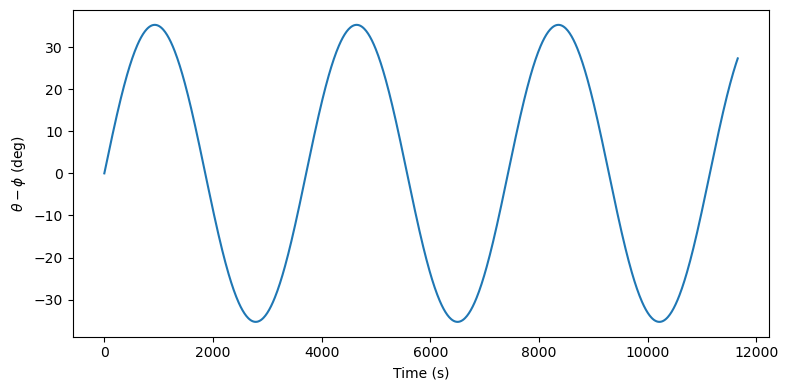

In [11]:
%matplotlib inline

import matplotlib.pylab as plt

fig = plt.figure(figsize=(8, 4))

plt.plot(trange, np.rad2deg(np.unwrap(res[:, 2] - np.arctan2(res[:, 1], res[:, 0]))))

plt.xlabel("Time (s)")
plt.ylabel(r"$\theta - \phi$ (deg)")

plt.tight_layout();

We can see that indeed the numerical integration matches well the theoretical prediction.

We can also produce an animation showing the oscillation of the dumbbell. In this animation, we are placing ourselves in the barycentre of the dumbbell in a non-rotating reference frame. The red line indicates the direction of the vertical -- that is, the direction of the centre of the Earth -- which will be rotating clockwise as the dumbbell travels along its orbit:

In [12]:
%%capture

from matplotlib import animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(111)

# Init the graphical elements.
m1_circle = plt.Circle((0.2, 0.0), 0.6, ec="black", fc="black", zorder=3)
m2_circle = plt.Circle((0.2, 0.0), 0.6, ec="black", fc="black", zorder=3)
(ln_vert,) = ax.plot([], [], "r", lw=1)
(ln_l,) = ax.plot([], [], "k", lw=3)

ax.add_artist(m1_circle)
ax.add_artist(m2_circle)


def init():
    ax.set_xlim((-10.0, 10.0))
    ax.set_ylim((-10.0, 10.0))
    ax.set_aspect("equal")
    return (m1_circle, m2_circle)


def animate(i):
    i = i * 3
    cur_x1, cur_y1 = res[i, 0:2]
    cur_th = res[i, 2]
    cur_x2 = cur_x1 + l * np.cos(cur_th)
    cur_y2 = cur_y1 + l * np.sin(cur_th)

    xB = (cur_x1 + cur_x2) / 2.0
    yB = (cur_y1 + cur_y2) / 2.0

    cur_x1 = cur_x1 - xB
    cur_y1 = cur_y1 - yB
    cur_x2 = cur_x2 - xB
    cur_y2 = cur_y2 - yB

    m1_circle.set_center((cur_x1, cur_y1))
    m2_circle.set_center((cur_x2, cur_y2))

    ln_vert.set_data([0, -xB], [0, -yB])
    ln_l.set_data([cur_x1, cur_x2], [cur_y1, cur_y2])

    return (m1_circle, m2_circle)


anim = HTML(
    animation.FuncAnimation(
        fig, animate, init_func=init, frames=300, interval=50, blit=True
    ).to_jshtml()
)

In [13]:
anim

## Adding a spring and damping

At this stage the attitude of our dumbbell spacecraft has not been fully stabilised -- rather, it has been confined to a libration motion around the vertical. In order to achieve true stabilisation, we need to add dissipation to the system. 

We will follow here the approach outlined in the [original paper](https://secwww.jhuapl.edu/techdigest/Content/techdigest/pdf/APL-V03-N05/APL-03-05-Fischell.pdf). Specifically, we will be adding a new mass $m_3$ connected to $m_2$ by a damped spring (rather than a massless rigid rod):

<img src="ggrad3.svg" width="600">

The spring has a rest length $d$ and an elastic constant $k$. The distance between the rest position and $m_3$ is $l_s$. The angle between the spring and the inertial $x$ direction is $\alpha$.

Let us begin by changing the value of $m_2$ and introducing the value for $m_3$. We want $m_2$ and $m_3$ to have a much lower mass than $m_1$, as in this setup they need to act as stabilizing counterweights for the larger mass $m_1$:

In [14]:
m2 = 1.0
m3 = 1.0

We then introduce values for the rest length $d$ and the elastic constant $k$. The value of $k$ has been taken from the original paper:

In [15]:
d = 1.0
k = 3.2e-5

$\alpha$ and $l_s$ are additional generalised coordinates. Let us introduce them and the corresponding velocities:

In [16]:
alpha, ls = hy.make_vars("alpha", "ls")
valpha, vls = hy.make_vars("valpha", "vls")

We can now introduce the cartesian position of $m_3$ as a function of the generalised coordinates:

$$
\begin{cases}
x_3 & = x_1 + l\cos\theta + \left( l_s + d \right)\cos\alpha \\
y_3 & = y_1 + l\sin\theta + \left( l_s + d \right)\sin\alpha
\end{cases}.
$$

The Cartesian velocity of $m_3$ can again be computed by symbolic differentiation:

In [17]:
# Cartesian position of m3.
x3 = x1 + l * hy.cos(theta) + (ls + d) * hy.cos(alpha)
y3 = y1 + l * hy.sin(theta) + (ls + d) * hy.sin(alpha)

# Cartesian velocity of m3.
vx3, vy3 = hy.diff_tensors([x3, y3], diff_args=[x1, y1, theta, alpha, ls]).jacobian @ [
    vx1,
    vy1,
    vtheta,
    valpha,
    vls,
]

We are now ready to formulate the kinetic energy. With respect to the previous setup, we just need to add the kinetic energy term for $m_3$:

In [18]:
T = 0.5 * (m1 * (vx1**2 + vy1**2) + m2 * (vx2**2 + vy2**2) + m3 * (vx3**2 + vy3**2))

Regarding the potential, we need to add a new gravitational potential term due to $m_3$ and the elastic potential due to the spring:

$$
V = -\mu\left( \frac{m_1}{\sqrt{x_1^2+y_1^2}} + \frac{m_2}{\sqrt{x_2^2+y_2^2}} + \frac{m_3}{\sqrt{x_3^2+y_3^2}}\right) + \frac{1}{2}kl_s^2.
$$

In [19]:
V = (
    -mu
    * (
        m1 / hy.sqrt(x1**2 + y1**2)
        + m2 / hy.sqrt(x2**2 + y2**2)
        + m3 / hy.sqrt(x3**2 + y3**2)
    )
    + 0.5 * k * ls**2
)

We can now proceed to introduce the new Lagrangian:

In [20]:
L = T - V

We are now ready to formulate the Euler-Lagrange equations. In order to introduce dissipation in the spring, we will be employing the following [Rayleigh dissipation function](https://en.wikipedia.org/wiki/Rayleigh_dissipation_function):

$$
D = c\dot{l}_s^2,
$$

where $c$ is a damping coefficient. Adding $D$ to the Euler-Lagrange equations will introduce a linear friction force in the motion of the spring. Let us see:

In [21]:
# The damping coefficient.
c = 1e-2

# Formulate the Euler-Lagrange equations.
sys = hy.lagrangian(
    L,
    [x1, y1, theta, alpha, ls],
    [vx1, vy1, vtheta, valpha, vls],
    # The dissipation function.
    c * vls**2,
)

We can now proceed to numerically integrate the system. The initial conditions are the same as in the previous setup:

In [22]:
# Create the integrator object.
ta = hy.taylor_adaptive(
    sys, [0.0, a, np.pi / 2, np.pi / 2, 0.0, np.sqrt(mu / a), 0.0, 0.0, 0.0, 0.0]
)

# Integrate for 10 orbits.
trange = np.linspace(0.0, 10 * Torb, 1000)
res = ta.propagate_grid(trange)[-1]

Let us take a look at the time evolution of $\theta - \phi$ and $\alpha - \phi$: 

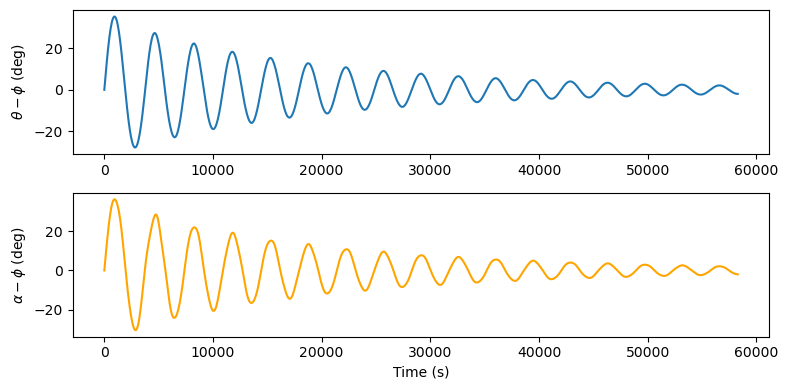

In [23]:
fig = plt.figure(figsize=(8, 4))

ax = plt.subplot(211)

ax.plot(trange, np.rad2deg(np.unwrap(res[:, 2] - np.arctan2(res[:, 1], res[:, 0]))))

ax.set_ylabel(r"$\theta - \phi$ (deg)")

ax = plt.subplot(212)

ax.plot(
    trange,
    np.rad2deg(np.unwrap(res[:, 3] - np.arctan2(res[:, 1], res[:, 0]))),
    "orange",
)

ax.set_xlabel("Time (s)")
ax.set_ylabel(r"$\alpha - \phi$ (deg)")

plt.tight_layout();

We can clearly see how energy dissipation is stabilising the spacecraft along the vertical direction. Let us also take a look at what is going on visually:

In [24]:
%%capture

from matplotlib import animation
from IPython.display import HTML

fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(111)

# Init the graphical elements.
m1_circle = plt.Circle((0.2, 0.0), 0.6, ec="black", fc="black", zorder=3)
m2_circle = plt.Circle((0.2, 0.0), 0.2, ec="black", fc="black", zorder=3)
m3_circle = plt.Circle((0.2, 0.0), 0.2, ec="black", fc="black", zorder=3)
(ln_vert,) = ax.plot([], [], "r", lw=1)
(ln_mvert,) = ax.plot([], [], "k--", lw=1)
(ln_l,) = ax.plot([], [], "k", lw=3)
(ln_ls,) = ax.plot([], [], "k", lw=3)

ax.add_artist(m1_circle)
ax.add_artist(m2_circle)
ax.add_artist(m3_circle)


def init():
    ax.set_xlim((-15.0, 15.0))
    ax.set_ylim((-15.0, 15.0))
    ax.set_aspect("equal")
    return (m1_circle, m2_circle, m3_circle)


def animate(i):
    i = i * 3

    cur_x1, cur_y1 = res[i, 0:2]
    cur_th = res[i, 2]
    cur_alpha = res[i, 3]
    cur_ls = res[i, 4]

    cur_x2 = cur_x1 + l * np.cos(cur_th)
    cur_y2 = cur_y1 + l * np.sin(cur_th)
    cur_x3 = cur_x1 + l * np.cos(cur_th) + (cur_ls + d) * np.cos(cur_alpha)
    cur_y3 = cur_y1 + l * np.sin(cur_th) + (cur_ls + d) * np.sin(cur_alpha)

    xB = (m1 * cur_x1 + m2 * cur_x2 + m3 * cur_x3) / (m1 + m2 + m3)
    yB = (m1 * cur_y1 + m2 * cur_y2 + m3 * cur_y3) / (m1 + m2 + m3)

    cur_x1 = cur_x1 - xB
    cur_y1 = cur_y1 - yB
    cur_x2 = cur_x2 - xB
    cur_y2 = cur_y2 - yB
    cur_x3 = cur_x3 - xB
    cur_y3 = cur_y3 - yB

    m1_circle.set_center((cur_x1, cur_y1))
    m2_circle.set_center((cur_x2, cur_y2))
    m3_circle.set_center((cur_x3, cur_y3))

    ln_vert.set_data([0, -xB], [0, -yB])
    ln_mvert.set_data([0, xB], [0, yB])
    ln_l.set_data([cur_x1, cur_x2], [cur_y1, cur_y2])
    ln_ls.set_data([cur_x2, cur_x3], [cur_y2, cur_y3])

    return (m1_circle, m2_circle, m3_circle)


anim = HTML(
    animation.FuncAnimation(
        fig, animate, init_func=init, frames=300, interval=50, blit=True
    ).to_jshtml()
)

In [25]:
anim

Like in the previous animation, the red line represents the vertical direction. The dashed black line extends the vertical outwards.

The decay of the initially-wide oscillations around the vertical is clearly visible. 